### Laboratorium 3 - zadania

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, slic

In [2]:
from lab3.lab3_utils import (
    plot_slic_analysis,
    plot_slic_comparison,
    plot_lab_analysis,
    plot_grayscale_analysis,
    get_evenly_markers,
    compare_watershed_and_slic,
    plot_watershed_comparison,
)

#### Zadanie 1

Dane są obrazy `tabby` i `caries` ([źródło](https://universe.roboflow.com/niu-workespeis/caries-xlrql/dataset/2)). Wykonaj dla nich segmentację przy użyciu algorytmu SLIC. Celem jest uzyskanie **jednolitych**  superpikseli, a więc zawierających tylko fragmenty obiektów lub tylko tła (a nie jednego i drugiego naraz). Przeanalizuj zachowanie algorytmu dla różnej liczby superpikseli i parametru sigma.

Zwróć uwagę, że wynikiem działania scikitowej implementacji SLIC - [`skimage.segmentation.slic`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.slic) - (podobnie jak wielu innych algorytmów klasyfikacyjnych) jest obraz typu `np.int64` przyporządkowujący każdemu pikselowi obrazu wejściowego indeks superpiksela. Takiej reprezentacji oczekuje też funkcja [`mark_boundaries`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.mark_boundaries).

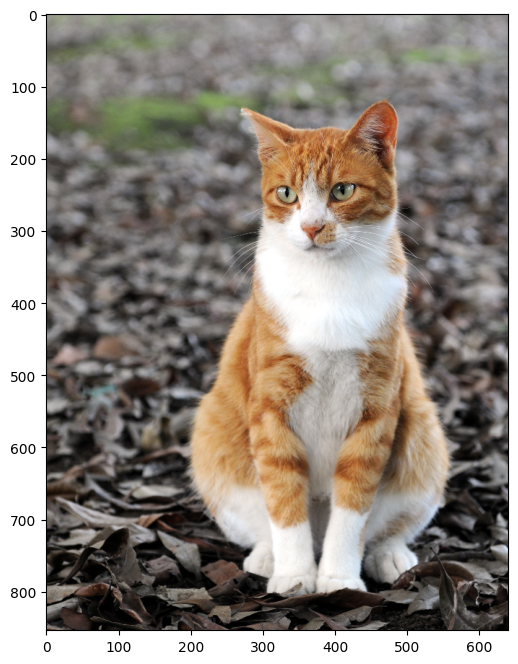

In [3]:
tabby = cv2.imread("lab3/tabby.jpg")[..., ::-1]
tabby = cv2.resize(tabby, dsize=None, fx=0.3, fy=0.3)
plt.subplots(1, 1, figsize=(8, 8))[1].imshow(tabby);

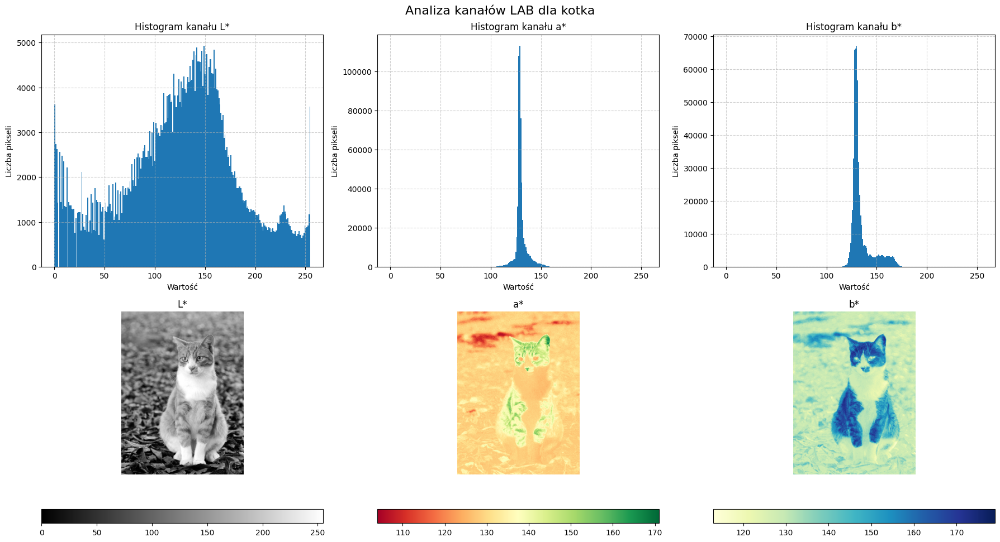

In [4]:
plot_lab_analysis(tabby, "tabby_cat")

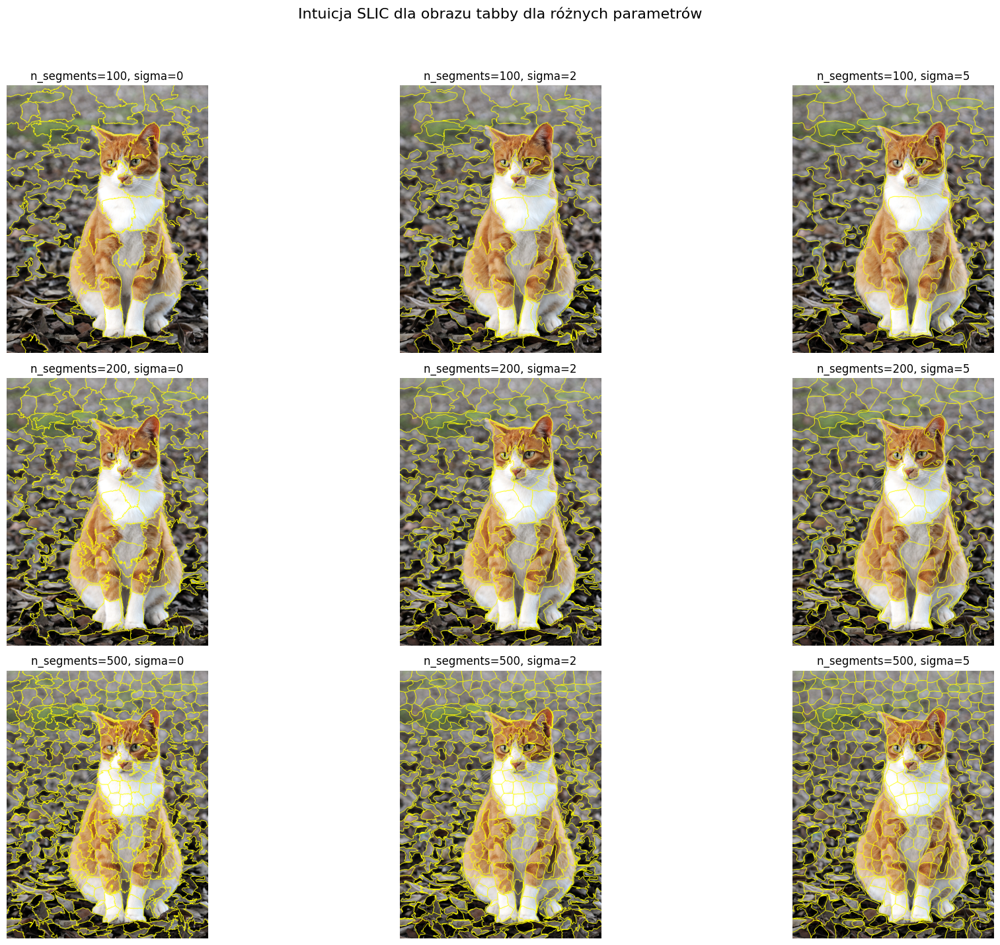

In [5]:
tabby_float = tabby.astype(np.float64) / 255.0
plot_slic_analysis(
    image=tabby_float,
    title_prefix="tabby",
    n_segments_list=[100, 200, 500],
    sigma_list=[0, 2, 5],
)

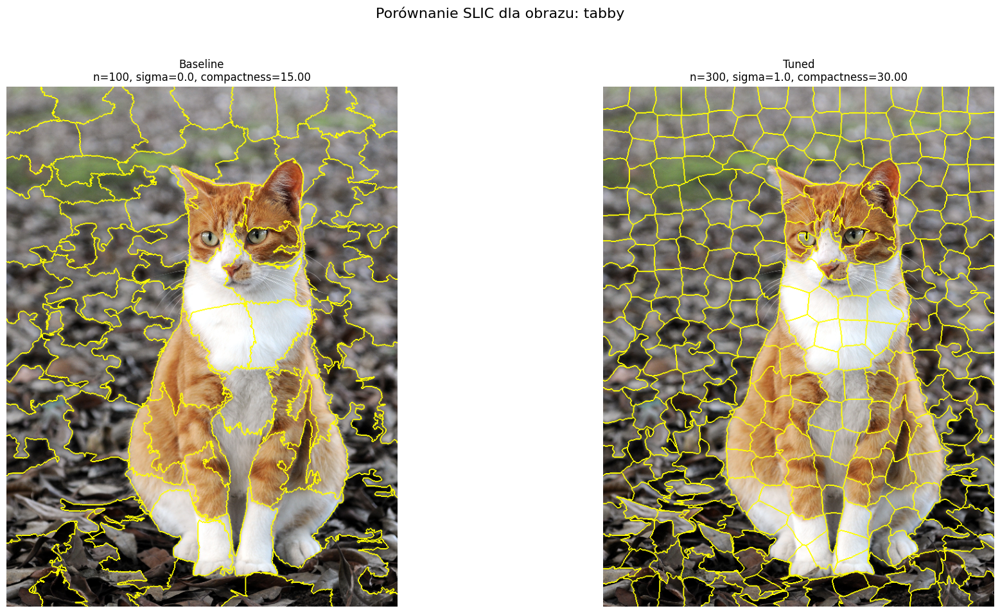

In [6]:
plot_slic_comparison(
    image=tabby_float,
    n_segments_base=100,
    sigma_base=0.0,
    compactness_base=15.0,
    n_segments_tuned=300,
    sigma_tuned=1.0,
    compactness_tuned=30.0,
    title_prefix="tabby",
)

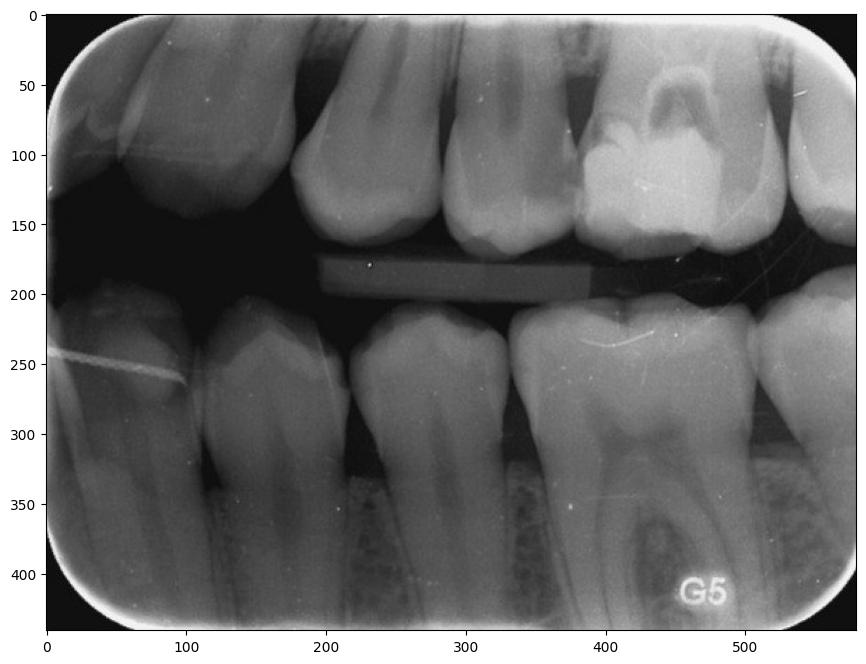

In [7]:
caries_117 = cv2.imread("lab3/roboflow-caries-117.jpg")[..., 0]
plt.subplots(1, 1, figsize=(12, 8))[1].imshow(caries_117, cmap="gray");

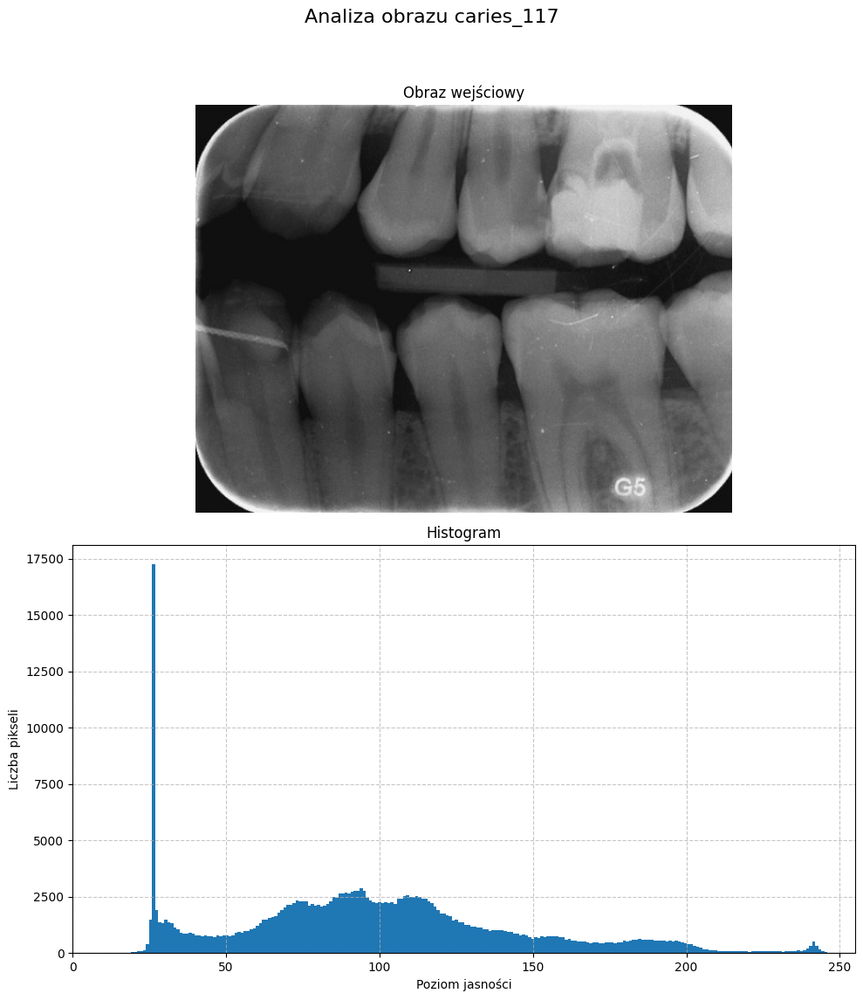

In [8]:
plot_grayscale_analysis(caries_117, "caries_117")

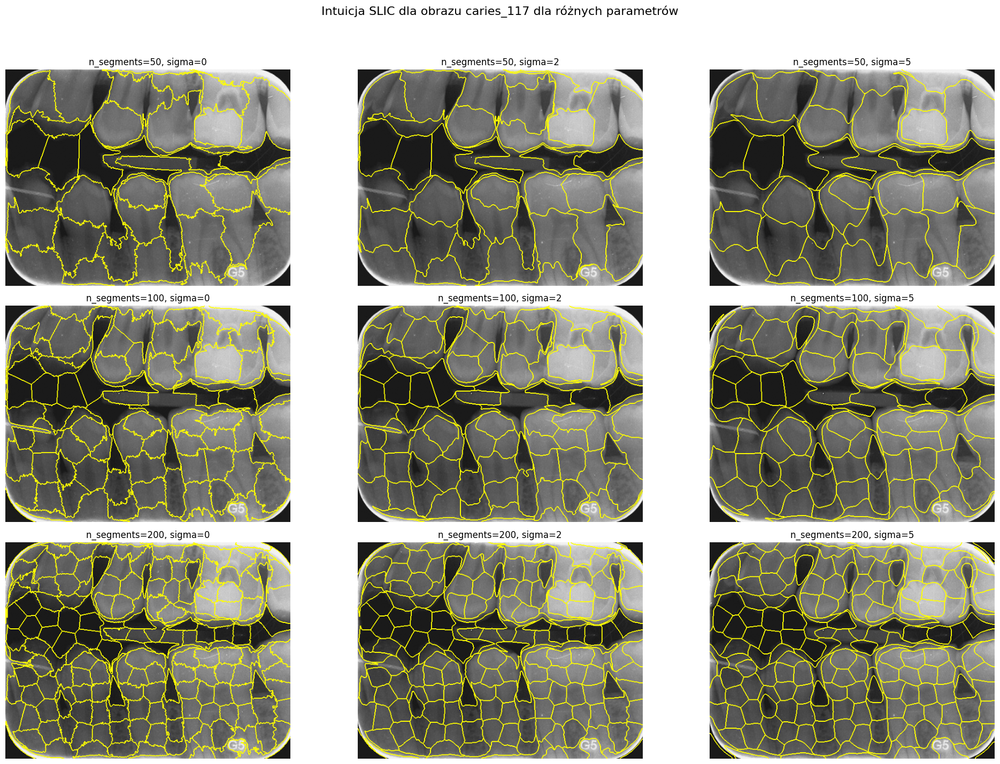

In [9]:
caries_117_float = caries_117.astype(float) / 255.0
plot_slic_analysis(
    image=caries_117_float,
    compactness=0.1,
    title_prefix="caries_117",
    n_segments_list=[50, 100, 200],
    sigma_list=[0, 2, 5],
)

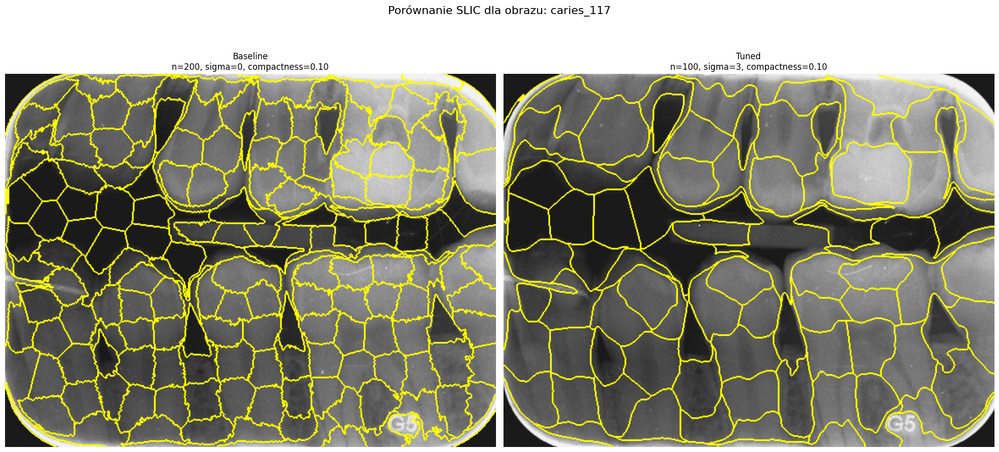

In [10]:
plot_slic_comparison(
    image=caries_117_float,
    n_segments_base=200,
    sigma_base=0,
    compactness_base=0.1,
    n_segments_tuned=100,
    sigma_tuned=3,
    compactness_tuned=0.1,
    title_prefix="caries_117",
)

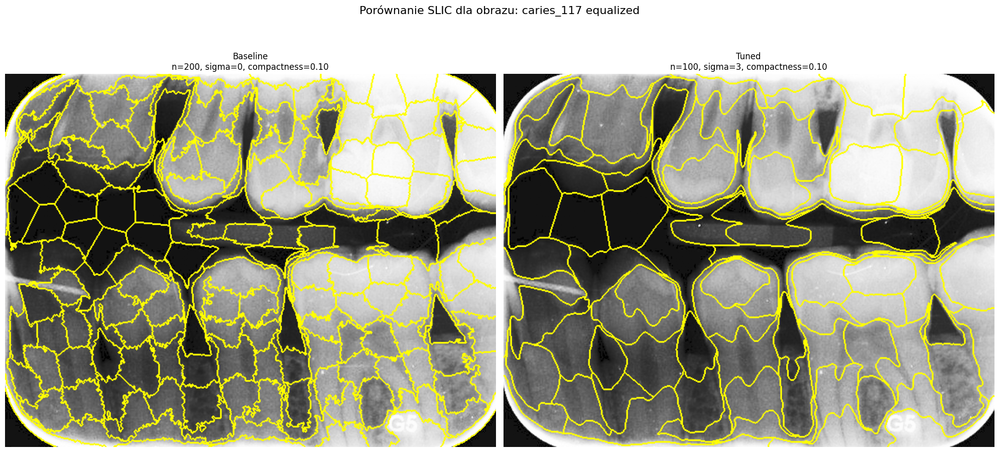

In [11]:
caries_117_eq = cv2.equalizeHist(caries_117)
plot_slic_comparison(
    image=caries_117_eq,
    n_segments_base=200,
    sigma_base=0,
    compactness_base=0.1,
    n_segments_tuned=100,
    sigma_tuned=3,
    compactness_tuned=0.1,
    title_prefix="caries_117 equalized",
)

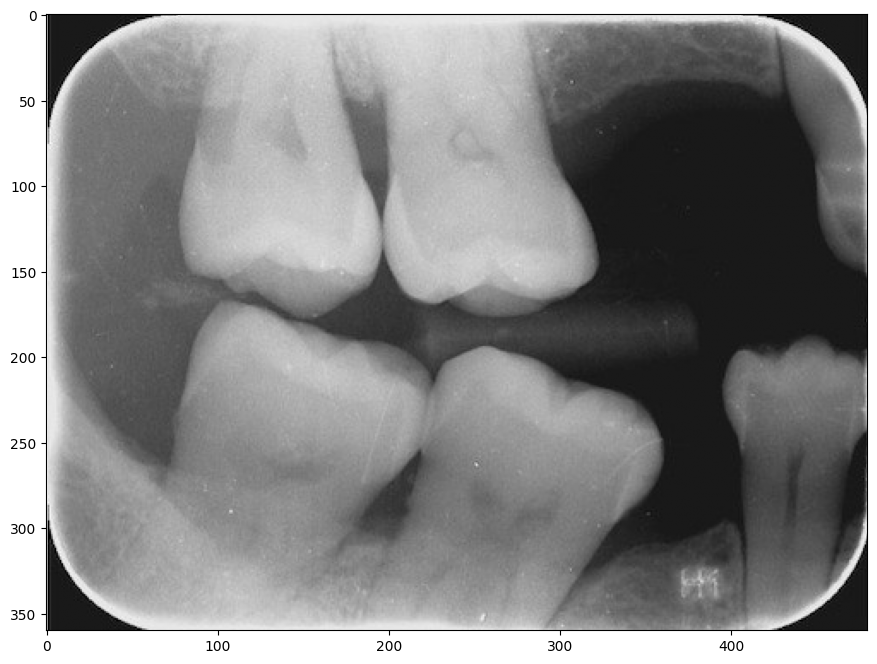

In [12]:
caries_128 = cv2.imread("lab3/roboflow-caries-128.jpg")[..., 0]
plt.subplots(1, 1, figsize=(12, 8))[1].imshow(caries_128, cmap="gray");

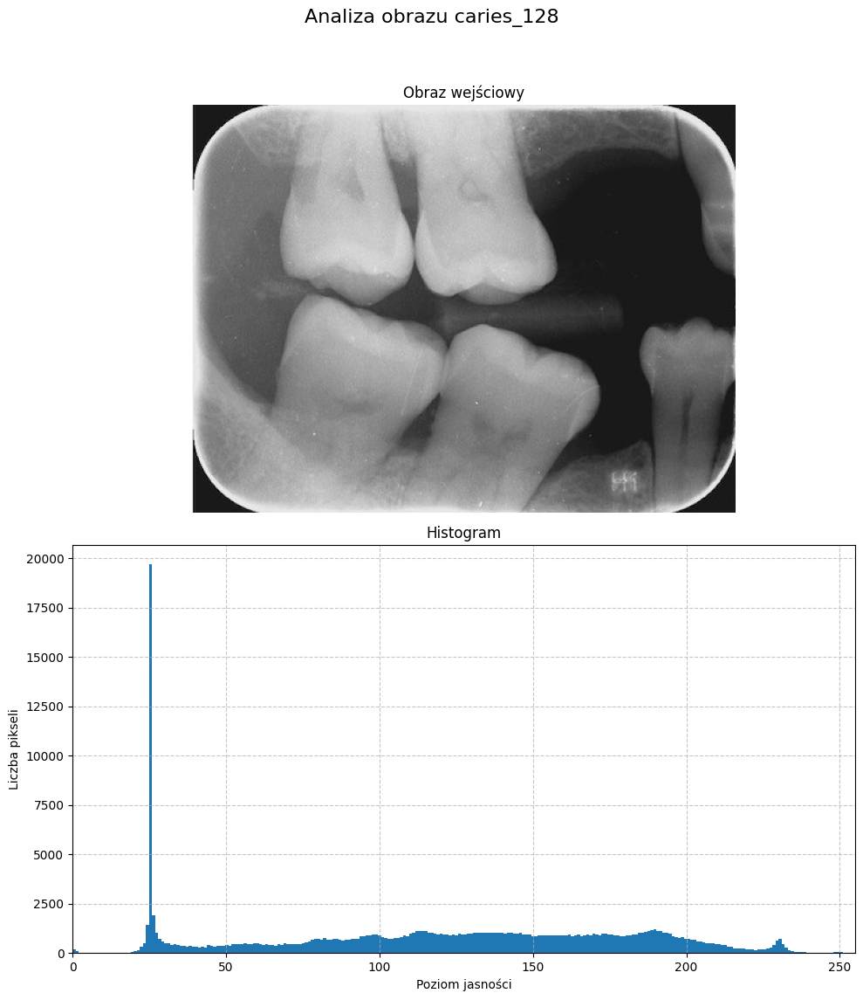

In [13]:
plot_grayscale_analysis(caries_128, "caries_128")

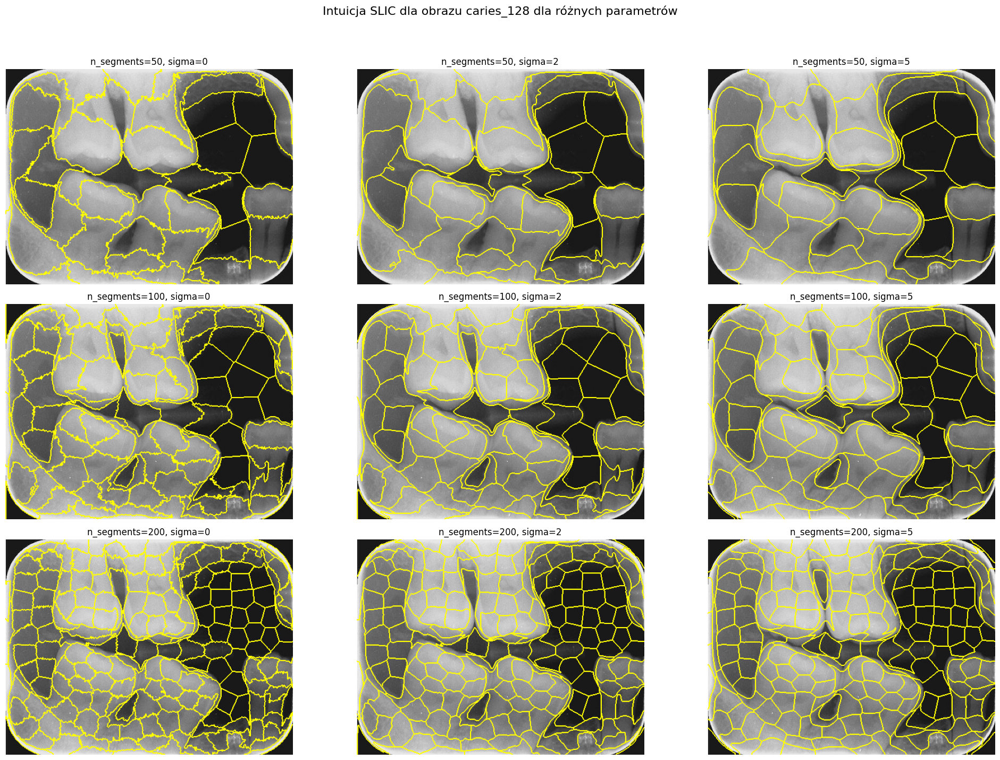

In [14]:
caries_128_float = caries_128.astype(float) / 255.0
plot_slic_analysis(
    image=caries_128_float,
    compactness=0.1,
    title_prefix="caries_128",
    n_segments_list=[50, 100, 200],
    sigma_list=[0, 2, 5],
)

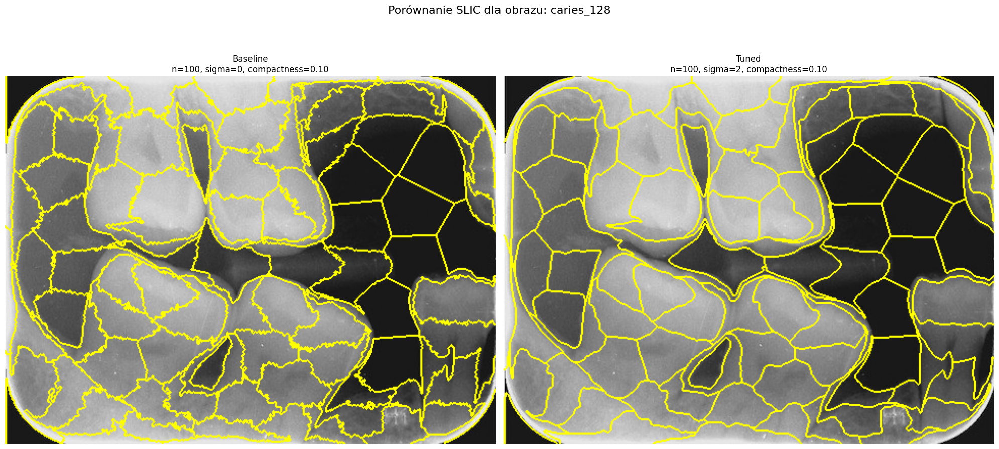

In [15]:
plot_slic_comparison(
    image=caries_128_float,
    n_segments_base=100,
    sigma_base=0,
    compactness_base=0.1,
    n_segments_tuned=100,
    sigma_tuned=2,
    compactness_tuned=0.1,
    title_prefix="caries_128",
)

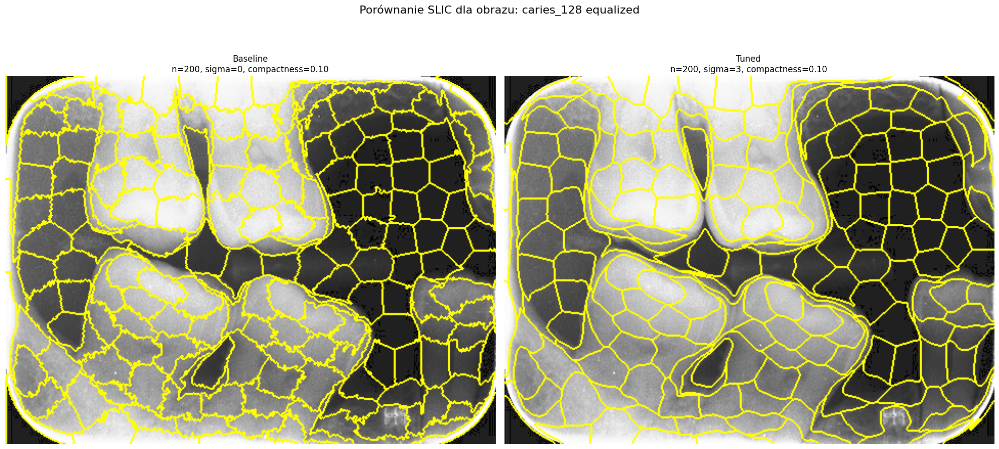

In [16]:
caries_128_eq = cv2.equalizeHist(caries_128)
plot_slic_comparison(
    image=caries_128_eq,
    n_segments_base=200,
    sigma_base=0,
    compactness_base=0.1,
    n_segments_tuned=200,
    sigma_tuned=3,
    compactness_tuned=0.1,
    title_prefix="caries_128 equalized",
)

#### Zadanie 2

Wykonaj segmentację wododziałową dla obrazów `tabby` i `caries` za pomocą funkcji [`cv2.watershed`](https://docs.opencv.org/4.x/d3/d47/group__imgproc__segmentation.html#ga3267243e4d3f95165d55a618c65ac6e1). Implementacja OpenCV przyjmuje dwa argumenty: obraz wejściowy (8-bit, 3 kanały) i obraz wyjściowy (32-bit, 1 kanał).

Uwaga: obraz wyjściowy musi zawierać oznaczenia początkowe segmentów (_markery_) - to znaczy, że musisz zacząć od przygotowania macierzy markerów. Poprawnie przygotowana macierz zawiera $N$ markerów, tj. pikseli oznaczonych liczbami całkowitymi od 1 do $N$, a wartość pozostałych pikseli wynosi 0. Piksele zerowe zostaną przyporządkowane do grup dookoła markerów.

Sugerowane metody przygotowania markerów (wybierz dwie i porównaj):
* równomierna siatka
* lokalne minima jasności
* manualnie wybrane centra (_segmentacja interaktywna_)
* lub inna sasmemu znalexc

### Tabby

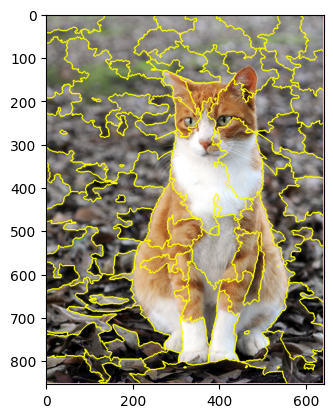

In [17]:
markers = get_evenly_markers(tabby, 100)
cv2.watershed(tabby, markers)
plt.imshow(mark_boundaries(tabby, markers))

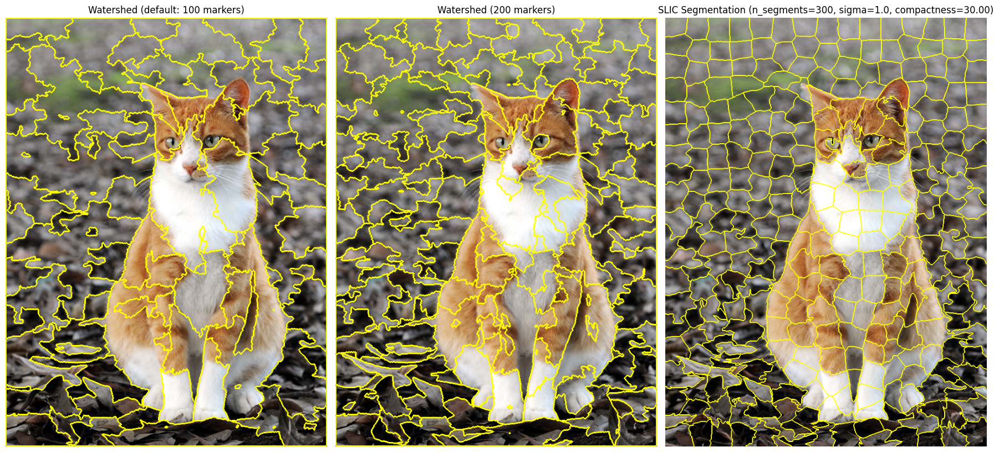

In [18]:
compare_watershed_and_slic(
    tabby, default_marker_num=100, marker_num=200, n_seg=300, sig=1.0, comp=30
)

41


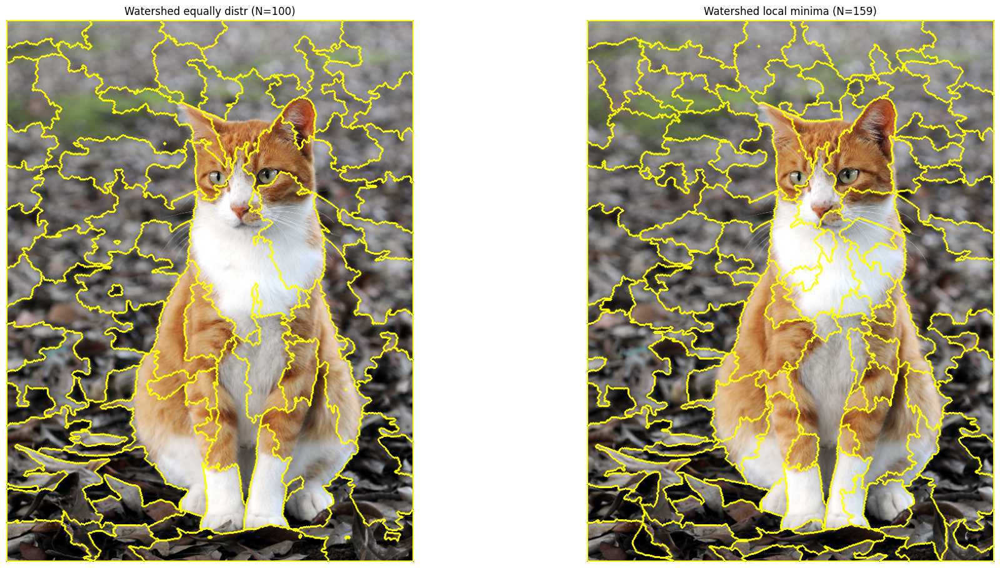

In [19]:
plot_watershed_comparison(tabby, 100, title_prefix="tabby")

# Caries

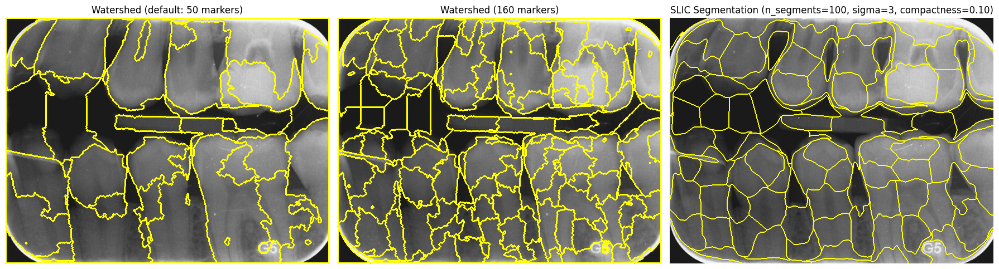

In [20]:
caries_117_3_channel = cv2.cvtColor(caries_117, cv2.COLOR_GRAY2RGB)
compare_watershed_and_slic(
    caries_117_3_channel,
    default_marker_num=50,
    marker_num=160,
    n_seg=100,
    sig=3,
    comp=0.1,
    gray=True,
)

40


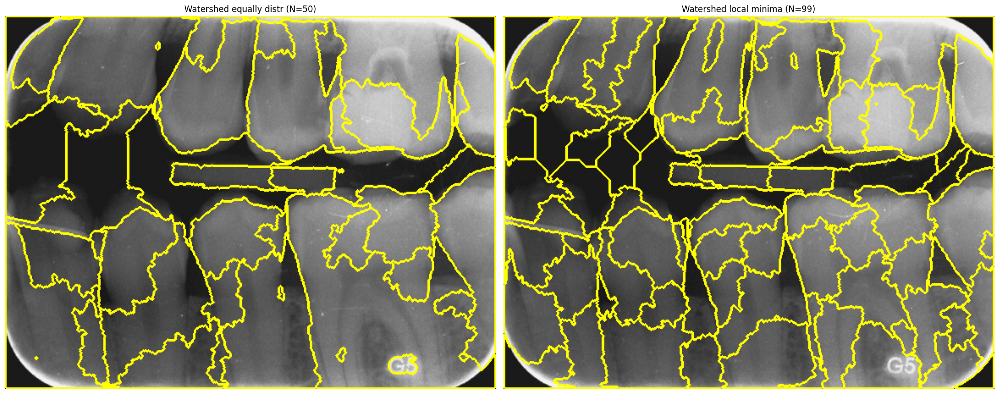

In [21]:
plot_watershed_comparison(caries_117, 50, title_prefix="caries_117")

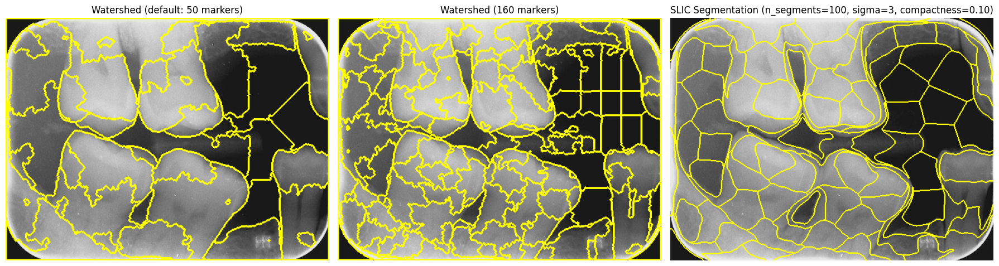

In [22]:
caries_128_3_channel = cv2.cvtColor(caries_128, cv2.COLOR_GRAY2RGB)
compare_watershed_and_slic(
    caries_128_3_channel,
    default_marker_num=50,
    marker_num=160,
    n_seg=100,
    sig=3,
    comp=0.1,
    gray=True,
)

33


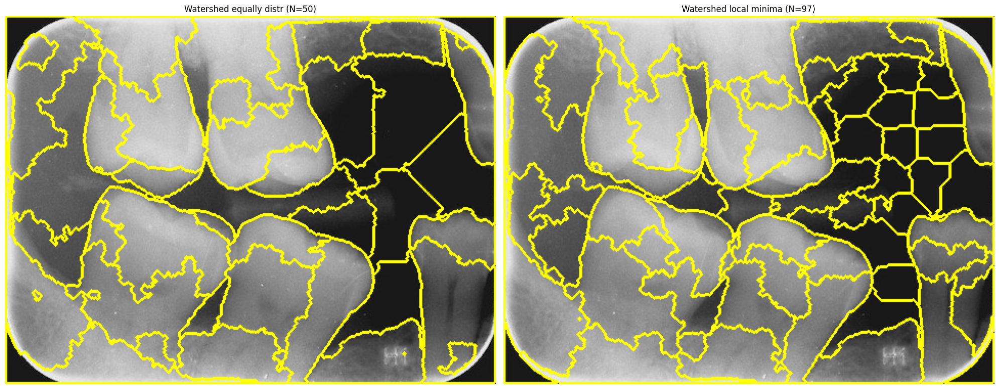

In [23]:
plot_watershed_comparison(caries_128, 50, title_prefix="caries_117")